# Experimental Protocol

## Introduction
Subjects performed different motor/imagery tasks while 64-channel EEG were recorded using the BCI2000 system ([BCI2000 website](http://www.bci2000.org)). 

## Experimental Runs
Each subject performed 14 experimental runs:
1. Two one-minute baseline runs:
   - Baseline with eyes open
   - Baseline with eyes closed
2. Three two-minute runs of each of the following tasks:
   1. Task 1: Open and close left or right fist
   2. Task 2: Imagine opening and closing left or right fist
   3. Task 3: Open and close both fists or both feet
   4. Task 4: Imagine opening and closing both fists or both feet

## Summary of Experimental Runs
1. Baseline, eyes open
2. Baseline, eyes closed
3. Task 1 (open and close left or right fist)
4. Task 2 (imagine opening and closing left or right fist)
5. Task 3 (open and close both fists or both feet)
6. Task 4 (imagine opening and closing both fists or both feet)
7. Task 1
8. Task 2
9. Task 3
10. Task 4
11. Task 1
12. Task 2
13. Task 3
14. Task 4

## Data Format
The data are provided in EDF+ format, containing:
- 64 EEG signals
- Sampled at 160 samples per second
- Annotation channel

## Annotations
Each annotation includes one of three codes (`T0`, `T1`, or `T2`):
- `T0`: Rest
- `T1`: Onset of motion (real or imagined) of
  - Left fist
  - Both fists
- `T2`: Onset of motion (real or imagined) of
  - Right fist
  - Both feet


# Getting all the paths

In [1]:
import mne
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import librosa
import librosa.display

data_path=[]
event_data_path=[]
for i in range(1,15):
    if i<10:
      data_path.append('files/S001/S001R0'+str(i)+'.edf')
      event_data_path.append('files/S001/S001R0'+str(i)+'.edf.event')
    else:
      data_path.append('files/S001/S001R'+str(i)+'.edf')
      event_data_path.append('files/S001/S001R'+str(i)+'.edf.event')
        
# raw = mne.io.read_raw_edf(data_path[2], preload=True)

# print(raw)

# Importing all the paths

In [2]:
raw=[]
for i in range(0,14):
  raw.append(mne.io.read_raw_edf(data_path[i], preload=True))

Extracting EDF parameters from d:\IIIT\IIIT_Shri_City\SEMESTER 6\BCI\Project\dataset\files\S001\S001R01.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Extracting EDF parameters from d:\IIIT\IIIT_Shri_City\SEMESTER 6\BCI\Project\dataset\files\S001\S001R02.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 9759  =      0.000 ...    60.994 secs...
Extracting EDF parameters from d:\IIIT\IIIT_Shri_City\SEMESTER 6\BCI\Project\dataset\files\S001\S001R03.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Extracting EDF parameters from d:\IIIT\IIIT_Shri_City\SEMESTER 6\BCI\Project\dataset\files\S001\S001R04.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 19999  =      0.000 ...   124.994 secs...
Ex

# Correcting the channel mapping of all the raw data

In [3]:
channel_mapping = {'Fc5.': 'FC5', 'Fc3.': 'FC3', 'Fc1.': 'FC1', 'Fcz.': 'FCz', 'Fc2.': 'FC2', 'Fc4.': 'FC4', 'Fc6.': 'FC6', 'C5..': 'C5', 'C3..': 'C3', 'C1..': 'C1', 'Cz..': 'Cz', 'C2..': 'C2', 'C4..': 'C4', 'C6..': 'C6', 'Cp5.': 'CP5', 'Cp3.': 'CP3', 'Cp1.': 'CP1', 'Cpz.': 'CPz', 'Cp2.': 'CP2', 'Cp4.': 'CP4', 'Cp6.': 'CP6', 'Fp1.': 'Fp1', 'Fpz.': 'Fpz', 'Fp2.': 'Fp2', 'Af7.': 'AF7', 'Af3.': 'AF3', 'Afz.': 'AFz', 'Af4.': 'AF4', 'Af8.': 'AF8', 'F7..': 'F7', 'F5..': 'F5', 'F3..': 'F3', 'F1..': 'F1', 'Fz..': 'Fz', 'F2..': 'F2', 'F4..': 'F4', 'F6..': 'F6', 'F8..': 'F8', 'Ft7.': 'FT7', 'Ft8.': 'FT8', 'T7..': 'T7', 'T8..': 'T8', 'T9..': 'T9', 'T10.': 'T10', 'Tp7.': 'TP7', 'Tp8.': 'TP8', 'P7..': 'P7', 'P5..': 'P5', 'P3..': 'P3', 'P1..': 'P1', 'Pz..': 'Pz', 'P2..': 'P2', 'P4..': 'P4', 'P6..': 'P6', 'P8..': 'P8', 'Po7.': 'PO7', 'Po3.': 'PO3', 'Poz.': 'POz', 'Po4.': 'PO4', 'Po8.': 'PO8', 'O1..': 'O1', 'Oz..': 'Oz', 'O2..': 'O2', 'Iz..': 'Iz'}
for i in range(0,14):
	raw[i].rename_channels(channel_mapping)
	raw[i].set_montage('standard_1005')


In [4]:
raw[0].compute_psd()

Effective window size : 12.800 (s)


Data type,Power Spectrum
Units,eeg: V²/Hz
Data source,Raw
Dims,"channel, freq"
Estimation method,welch
Number of channels,64
Number of frequency bins,1025
Frequency range,0.00 – 80.00 Hz


In [5]:
raw[0].info['ch_names']

['FC5',
 'FC3',
 'FC1',
 'FCz',
 'FC2',
 'FC4',
 'FC6',
 'C5',
 'C3',
 'C1',
 'Cz',
 'C2',
 'C4',
 'C6',
 'CP5',
 'CP3',
 'CP1',
 'CPz',
 'CP2',
 'CP4',
 'CP6',
 'Fp1',
 'Fpz',
 'Fp2',
 'AF7',
 'AF3',
 'AFz',
 'AF4',
 'AF8',
 'F7',
 'F5',
 'F3',
 'F1',
 'Fz',
 'F2',
 'F4',
 'F6',
 'F8',
 'FT7',
 'FT8',
 'T7',
 'T8',
 'T9',
 'T10',
 'TP7',
 'TP8',
 'P7',
 'P5',
 'P3',
 'P1',
 'Pz',
 'P2',
 'P4',
 'P6',
 'P8',
 'PO7',
 'PO3',
 'POz',
 'PO4',
 'PO8',
 'O1',
 'Oz',
 'O2',
 'Iz']

In [6]:
raw_temp = raw[2]
annotations_temp = raw_temp.annotations
print(annotations_temp)
codes_temp = annotations_temp.description
print("Names of 64 Channels")
print(raw_temp.ch_names)
print("Acitivity/Target associated with samples")
print(codes_temp)
annotations=[]
codes=[]
for i in range(0,14):
  annotations.append(raw[i].annotations)
  codes.append(annotations[i].description)


<Annotations | 30 segments: T0 (15), T1 (8), T2 (7)>
Names of 64 Channels
['FC5', 'FC3', 'FC1', 'FCz', 'FC2', 'FC4', 'FC6', 'C5', 'C3', 'C1', 'Cz', 'C2', 'C4', 'C6', 'CP5', 'CP3', 'CP1', 'CPz', 'CP2', 'CP4', 'CP6', 'Fp1', 'Fpz', 'Fp2', 'AF7', 'AF3', 'AFz', 'AF4', 'AF8', 'F7', 'F5', 'F3', 'F1', 'Fz', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FT8', 'T7', 'T8', 'T9', 'T10', 'TP7', 'TP8', 'P7', 'P5', 'P3', 'P1', 'Pz', 'P2', 'P4', 'P6', 'P8', 'PO7', 'PO3', 'POz', 'PO4', 'PO8', 'O1', 'Oz', 'O2', 'Iz']
Acitivity/Target associated with samples
['T0' 'T2' 'T0' 'T1' 'T0' 'T1' 'T0' 'T2' 'T0' 'T2' 'T0' 'T1' 'T0' 'T1'
 'T0' 'T2' 'T0' 'T1' 'T0' 'T2' 'T0' 'T2' 'T0' 'T1' 'T0' 'T1' 'T0' 'T2'
 'T0' 'T1']


In [7]:
df = pd.DataFrame(raw[2].get_data().T, columns=[channel.replace(".","") for channel in raw[2].ch_names])
df = df[~(df == 0).all(axis=1)]
timeArray = np.array([round(x,3) for x in np.arange(0,len(df)/160,.00625)])
print(timeArray)
df

[0.00000e+00 6.00000e-03 1.20000e-02 ... 1.24481e+02 1.24488e+02
 1.24494e+02]


,FC5,FC3,FC1,FCz,FC2,FC4,FC6,C5,C3,C1,...,P8,PO7,PO3,POz,PO4,PO8,O1,Oz,O2,Iz
0,-0.000057,-0.000013,-0.000015,-0.000012,-0.000013,-0.000008,-0.000040,-0.000054,-0.000012,-0.000014,...,-0.000048,-0.000038,-0.000042,-0.000068,-0.000076,-0.000103,-0.000051,-0.000056,-0.000124,-0.000028
1,-0.000049,-0.000011,-0.000010,-0.000012,-0.000019,-0.000024,-0.000058,-0.000051,-0.000019,-0.000023,...,-0.000055,-0.000055,-0.000063,-0.000082,-0.000087,-0.000099,-0.000059,-0.000070,-0.000149,-0.000040
2,-0.000055,-0.000017,-0.000016,-0.000019,-0.000024,-0.000029,-0.000066,-0.000061,-0.000030,-0.000036,...,-0.000054,-0.000063,-0.000072,-0.000091,-0.000092,-0.000091,-0.000067,-0.000077,-0.000153,-0.000037
3,-0.000073,-0.000042,-0.000040,-0.000037,-0.000037,-0.000040,-0.000071,-0.000078,-0.000053,-0.000053,...,-0.000065,-0.000052,-0.000066,-0.000100,-0.000105,-0.000105,-0.000067,-0.000072,-0.000148,-0.000026
4,-0.000087,-0.000053,-0.000052,-0.000051,-0.000045,-0.000043,-0.000071,-0.000087,-0.000065,-0.000064,...,-0.000075,-0.000082,-0.000090,-0.000117,-0.000119,-0.000118,-0.000075,-0.000082,-0.000161,-0.000035
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19915,0.000023,0.000016,0.000014,0.000010,0.000010,0.000002,0.000017,0.000023,0.000024,0.000024,...,0.000013,0.000058,0.000053,0.000056,0.000042,0.000046,0.000076,0.000068,0.000086,0.000032
19916,0.000023,0.000023,0.000024,0.000020,0.000023,0.000014,0.000022,0.000031,0.000031,0.000038,...,0.000050,0.000061,0.000052,0.000072,0.000072,0.000079,0.000072,0.000082,0.000124,0.000051
19917,0.000023,0.000014,0.000011,0.000003,0.000005,-0.000003,0.000001,0.000021,0.000019,0.000025,...,0.000044,0.000024,0.000024,0.000066,0.000074,0.000085,0.000062,0.000097,0.000156,0.000075
19918,0.000038,0.000027,0.000028,0.000019,0.000019,0.000012,0.000009,0.000034,0.000032,0.000040,...,0.000025,0.000005,0.000011,0.000053,0.000051,0.000043,0.000044,0.000081,0.000140,0.000066


Annotations time of onsets: 
[  0.    4.2   8.3  12.5  16.6  20.8  24.9  29.1  33.2  37.4  41.5  45.7
  49.8  54.   58.1  62.3  66.4  70.6  74.7  78.9  83.   87.2  91.3  95.5
  99.6 103.8 107.9 112.1 116.2 120.4]


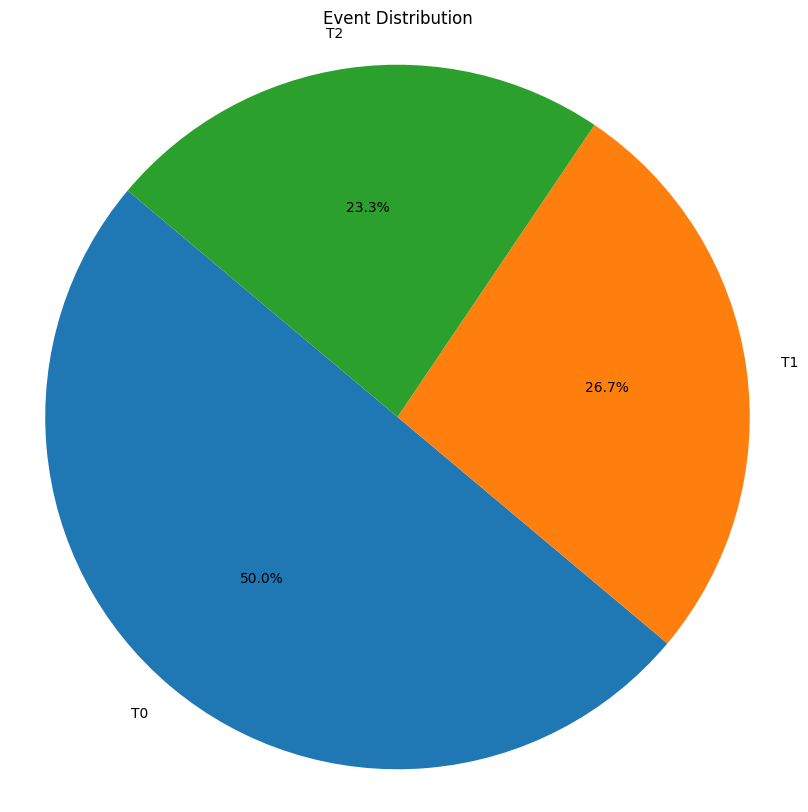

In [8]:
print("Annotations time of onsets: ")
print(annotations[2].onset)
event_counts = {'T0': 0, 'T1': 0, 'T2': 0}
total_events = len(codes[2])

for code in codes[2]:
    event_counts[code] += 1

# Plot pie chart
plt.figure(figsize=(10,10))
plt.pie(event_counts.values(), labels=event_counts.keys(), autopct='%1.1f%%', startangle=140)

# Customize the plot
plt.title('Event Distribution')

# Show plot
plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
plt.show()

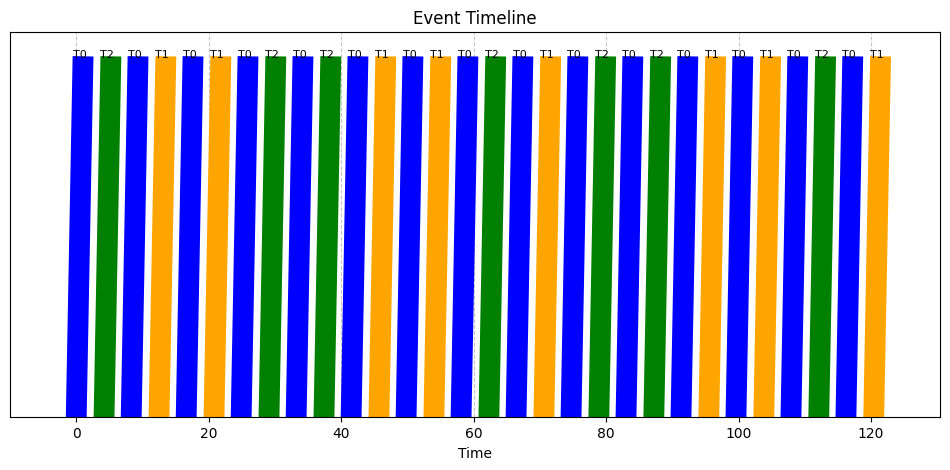

In [9]:
color_map = {'T0': 'blue', 'T1': 'orange', 'T2': 'green'}  # You can adjust colors as needed

# Plot events on a timeline
plt.figure(figsize=(12, 5))

for i, (onset, code) in enumerate(zip(annotations[2].onset, codes[2])):
    plt.plot([onset, onset + 1], [0, 1], color=color_map[code], linewidth=15)
    plt.text(onset + 0.5, 1.02, code, horizontalalignment='center', verticalalignment='bottom', fontsize=8)

# Customize the plot
plt.title('Event Timeline')
plt.xlabel('Time')
plt.yticks([])  # Remove y-axis ticks
plt.ylim(0, 1.1)  # Adjust y-axis limit to leave space for event codes

# Set x-axis limits with margins
xmin = annotations[3].onset.min() - 10
xmax = annotations[3].onset.max() + 10
plt.xlim(xmin, xmax)

plt.grid(axis='x', linestyle='--', alpha=0.7)

# Show plot
plt.show()

Plot of EEG signals
Using matplotlib as 2D backend.


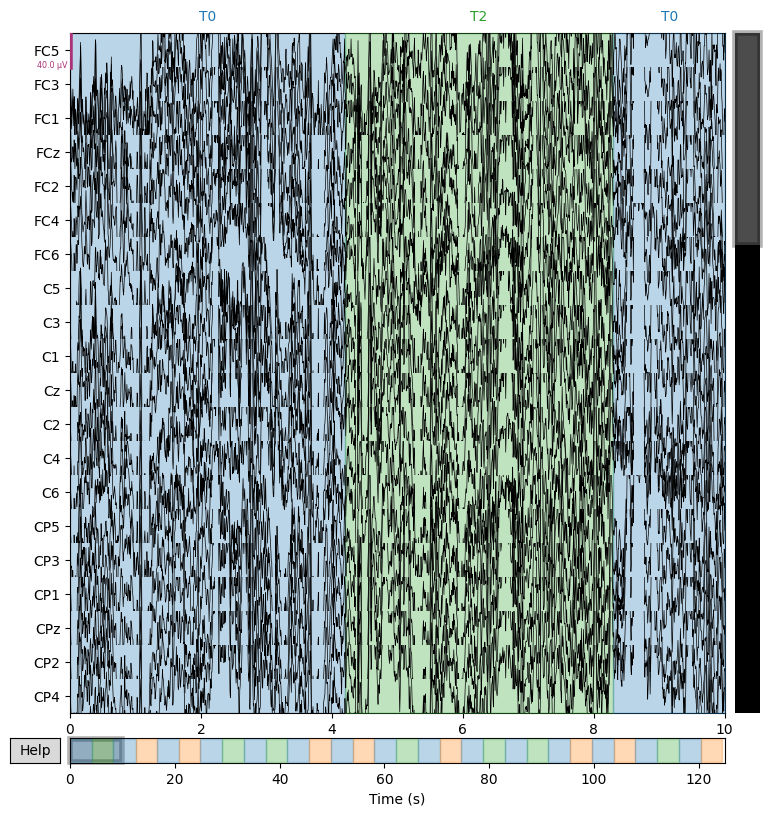

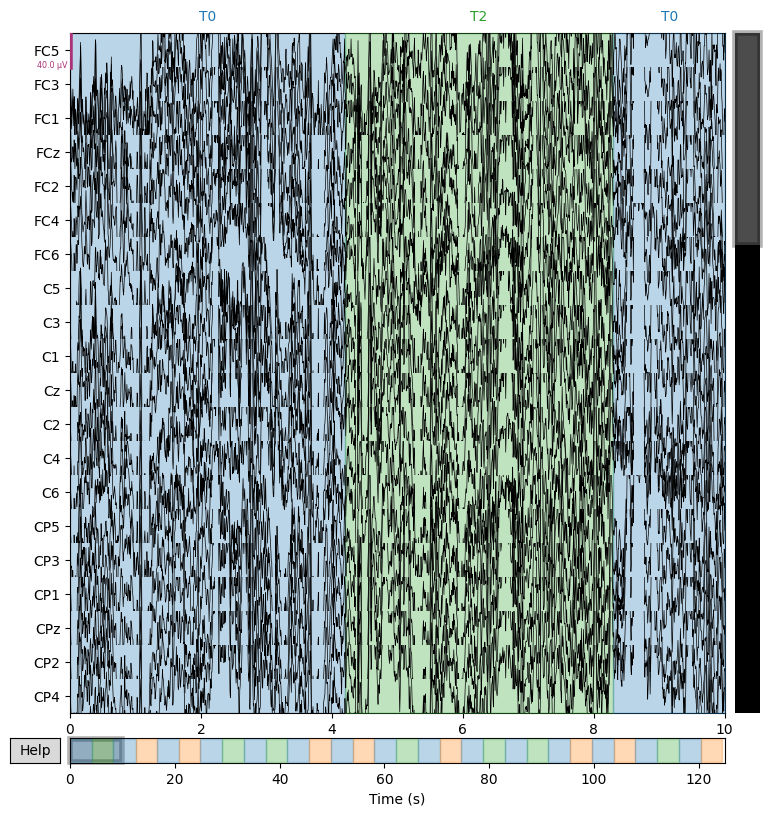

In [10]:
print("Plot of EEG signals")
raw[2].plot()

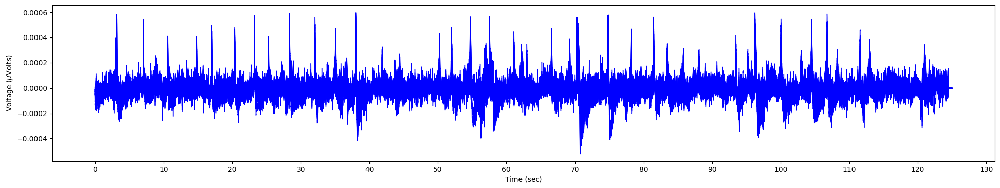

In [11]:
eeg_data, times = raw[2][:]
# Plot the time course of the EEG
plt.figure(figsize=(24, 4))
plt.plot(times, eeg_data.T, lw=1, color='blue')
plt.xlabel('Time (sec)')
plt.ylabel('Voltage ($\mu$Volts)')
plt.xticks(np.arange(0, times[-1] + 10, 10))
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_13248\1806607892.py:6: DeprecationWarning: Importing hann from 'scipy.signal' is deprecated since SciPy 1.1.0 and will raise an error in SciPy 1.13.0. Please use 'scipy.signal.windows.hann' or the convenience function 'scipy.signal.get_window' instead.
  window = hann(nperseg, sym=True)


[-3.62765456e-05+0.j -4.37276443e-05+0.j -5.10543254e-05+0.j ...
  0.00000000e+00+0.j  0.00000000e+00+0.j  0.00000000e+00+0.j]


C:\Users\HP\AppData\Local\Temp\ipykernel_13248\1806607892.py:13: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(timeGs, frequencies, 10 * np.log10(np.abs(Sxx[i])), shading='auto', cmap='jet')


Spectrograms using STFT transform using Hann window


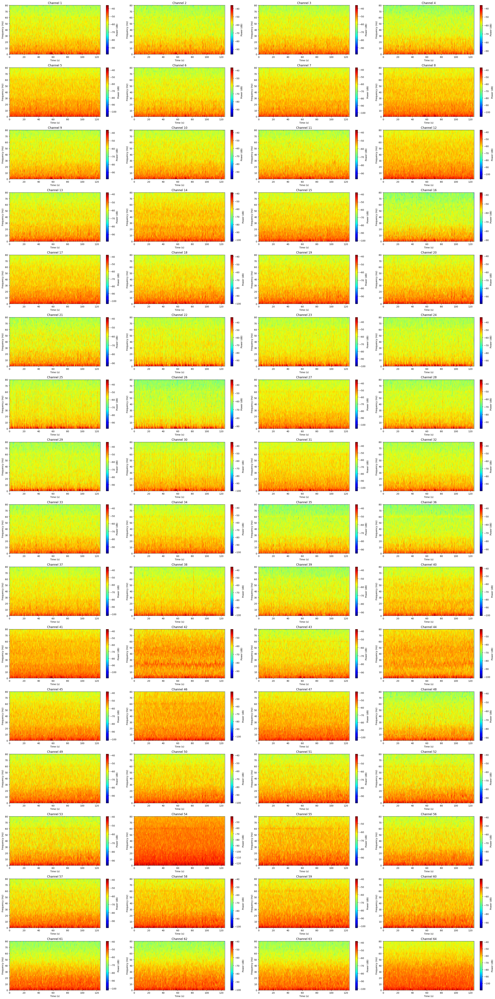

In [13]:
from scipy.signal import stft, hann
eeg = eeg_data
sr = 160
nperseg = int(0.5 * sr)  
noverlap = int(0.475 * sr)  
window = hann(nperseg, sym=True)
frequencies, timeGs, Sxx = stft(eeg, fs=sr, window=window, nperseg=nperseg, noverlap=noverlap)
print(Sxx[0][0])
plt.figure(figsize=(30, 60))

for i in range(eeg.shape[0]): 
    plt.subplot(16, 4, i+1)
    plt.pcolormesh(timeGs, frequencies, 10 * np.log10(np.abs(Sxx[i])), shading='auto', cmap='jet')
    plt.colorbar(label='Power (dB)')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.title(f'Channel {i+1}')
    plt.ylim(0, sr / 2)  

plt.subplots_adjust(top=0.9, bottom=0.1) 
plt.tight_layout()
print("Spectrograms using STFT transform using Hann window")  
plt.show()


C:\Users\HP\AppData\Local\Temp\ipykernel_13248\642876971.py:5: DeprecationWarning: Importing hann from 'scipy.signal' is deprecated since SciPy 1.1.0 and will raise an error in SciPy 1.13.0. Please use 'scipy.signal.windows.hann' or the convenience function 'scipy.signal.get_window' instead.
  window = hann(nperseg, sym=True)
C:\Users\HP\AppData\Local\Temp\ipykernel_13248\642876971.py:13: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(timeGs, frequencies, 10 * np.log10(np.abs(Sxx[i])), shading='auto', cmap='jet')


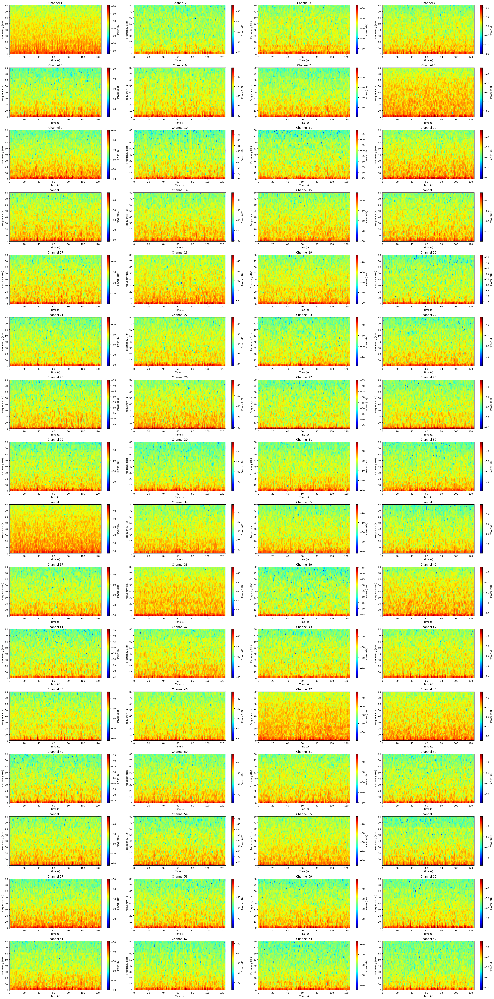

In [14]:
eeg = eeg_data
sr = 160
nperseg = int(0.5 * sr)  
noverlap = int(0.475 * sr)  
window = hann(nperseg, sym=True)
frequencies, timeGs, Sxx = stft(eeg, fs=sr, window=window, nperseg=nperseg, noverlap=noverlap)
Sxx= np.fft.fft(Sxx, axis=0)
# print(Sxx[0][0])
plt.figure(figsize=(30, 60))

for i in range(eeg.shape[0]):  
    plt.subplot(16, 4, i+1)
    plt.pcolormesh(timeGs, frequencies, 10 * np.log10(np.abs(Sxx[i])), shading='auto', cmap='jet')
    plt.colorbar(label='Power (dB)')
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.title(f'Channel {i+1}')
    plt.ylim(0, sr / 2)  

plt.subplots_adjust(top=0.9, bottom=0.1)
plt.tight_layout()
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_13248\3152163257.py:9: DeprecationWarning: scipy.signal.cwt is deprecated in SciPy 1.12 and will be removed
in SciPy 1.15. We recommend using PyWavelets instead.

  coef = cwt(eeg[i], morlet, scales)


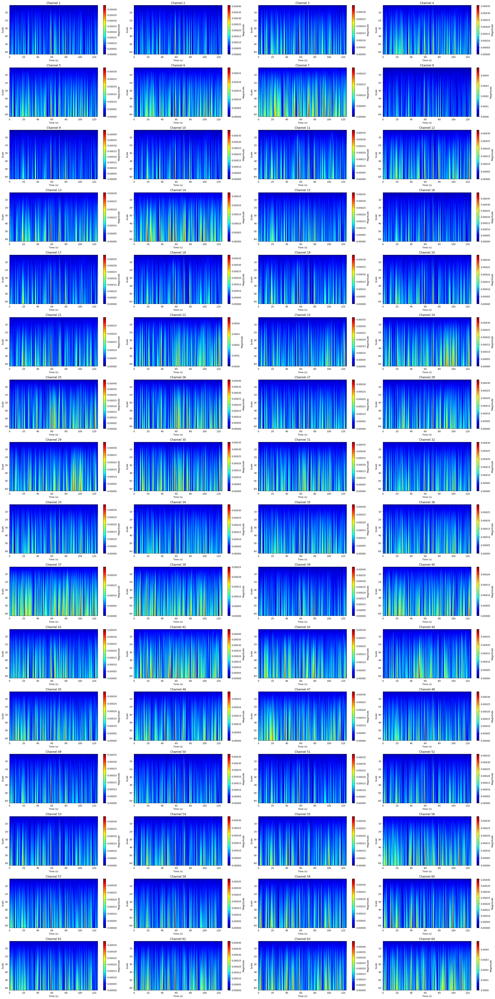

In [15]:
from scipy.signal import cwt, morlet
eeg = eeg_data
sr = 160
scales = np.arange(1, 64)  

plt.figure(figsize=(30, 60))

for i in range(eeg.shape[0]): 
    coef = cwt(eeg[i], morlet, scales) 
    plt.subplot(16, 4, i+1)
    plt.imshow(np.abs(coef), aspect='auto', extent=[0, len(eeg[i])/sr, scales[-1], scales[0]], cmap='jet')
    plt.colorbar(label='Magnitude')
    plt.xlabel('Time (s)')
    plt.ylabel('Scale')
    plt.title(f'Channel {i+1}')

plt.subplots_adjust(top=0.9, bottom=0.1)  
plt.tight_layout()
plt.show()

Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
125 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 125 events and 160 original time points ...
0 bad epochs dropped


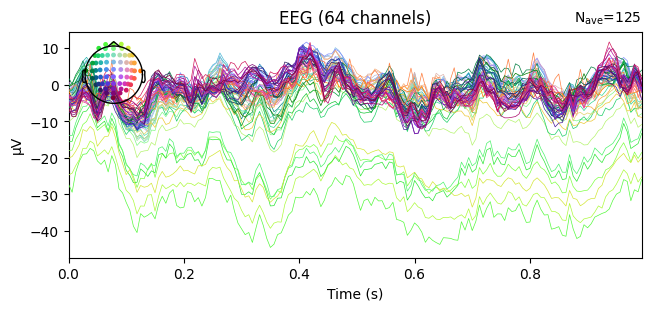

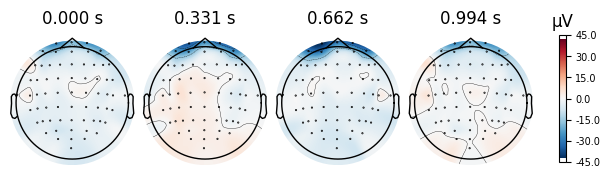

In [16]:
import matplotlib.pyplot as plt
import numpy as np
import mne

from mne.io import read_raw_edf
from mne import make_fixed_length_epochs

# Create info object
info = raw[2].info

# Create annotations
annotations = mne.events_from_annotations(raw[2])

# Define epochs
tmin, tmax = 0, 1  # Example time window
duration = tmax - tmin
epochs = make_fixed_length_epochs(raw[2], duration=duration, preload=True)

# Average epochs
evoked = epochs.average()

# Plot the evoked data
evoked.plot()
evoked.plot_topomap()

# Show plot
plt.show()


Channels with significant amplitude range: ['Fp1', 'Fpz', 'Fp2', 'AF7', 'AF3', 'AF8']
Used Annotations descriptions: ['T0', 'T1', 'T2']
Not setting metadata
30 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 30 events and 321 original time points ...
1 bad epochs dropped


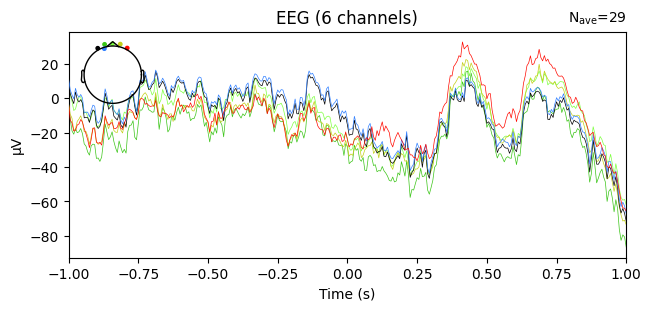

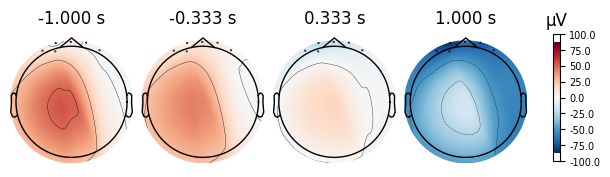

In [17]:
threshold=0.001

# Get the channel names and data
channel_names = raw[2].ch_names
data = raw[2].get_data()

# Calculate amplitude range for each channel
amplitude_ranges = np.ptp(data, axis=1)

# Find channels with a significant amplitude range
significant_channels = [ch for ch, amp_range in zip(channel_names, amplitude_ranges) if amp_range > threshold]

# Print significant channels
print("Channels with significant amplitude range:", significant_channels)

# Extract events from significant EEG channels
events, event_id = mne.events_from_annotations(raw[2], event_id=None)

# Epoch around events on significant channels
tmin, tmax = -1, 1  # Define time window around events
epochs = mne.Epochs(raw[2], events, event_id=event_id, tmin=tmin, tmax=tmax, baseline=None, picks=significant_channels, preload=True)

# Average epochs to obtain the ERP
evoked = epochs.average()

# Plot the ERP
evoked.plot()
evoked.plot_topomap()
# Show plot
plt.show()


Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1 events and 19840 original time points ...
0 bad epochs dropped
Not setting metadata
1 matching events found
No baseline correction applied
0 projection items activated
Using data from preloaded Raw for 1 events and 19840 original time points ...
0 bad epochs dropped


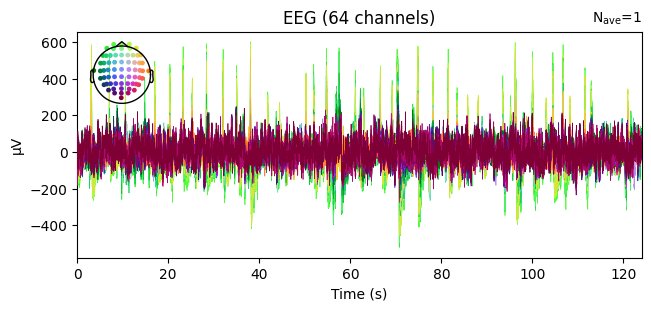

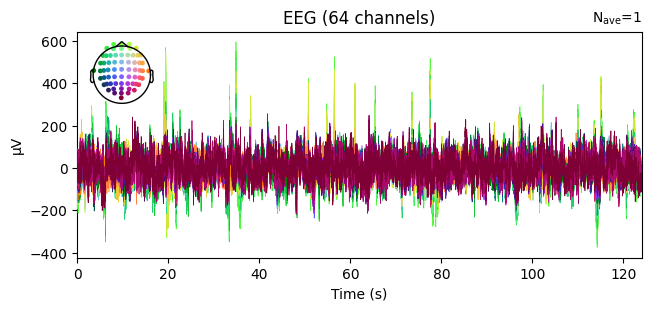

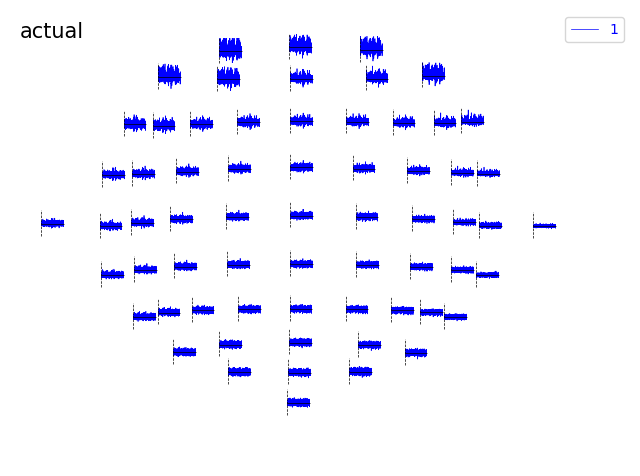

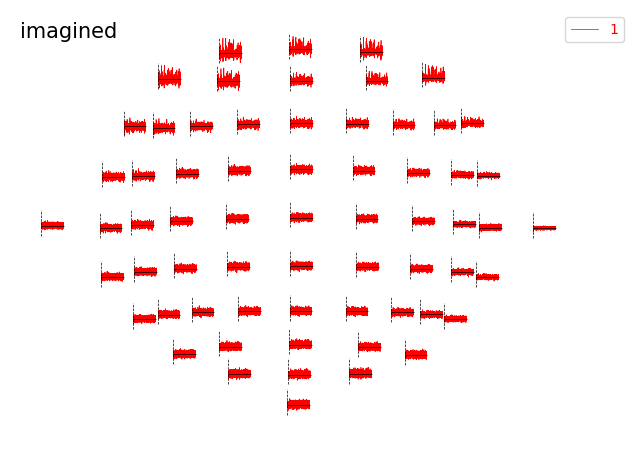

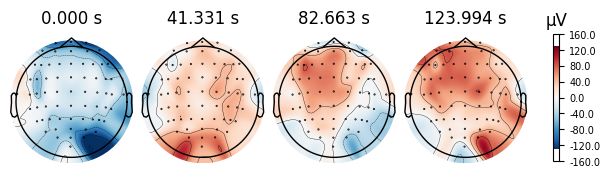

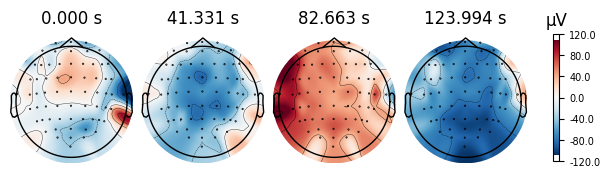

In [18]:
import matplotlib.pyplot as plt
from mne import make_fixed_length_epochs

# Create info objects
info = raw[2].info
info_imagine = raw[3].info

# Define epochs
tmin, tmax = 0, 124  # Example time window in seconds (2 minutes and 5 seconds)
duration = tmax - tmin
epochs = make_fixed_length_epochs(raw[2], duration=duration, preload=True)
epochs_imagine = make_fixed_length_epochs(raw[3], duration=duration, preload=True)

# Average epochs
evoked = epochs.average()
evoked_imagine = epochs_imagine.average()

# Plot the evoked data for each file with different colors
evoked.plot()
evoked_imagine.plot()
evoked.plot_topo(color='blue', title='actual')
evoked_imagine.plot_topo(color='red', title='imagined')
evoked.plot_topomap()
evoked_imagine.plot_topomap()
# Show plot
plt.show()

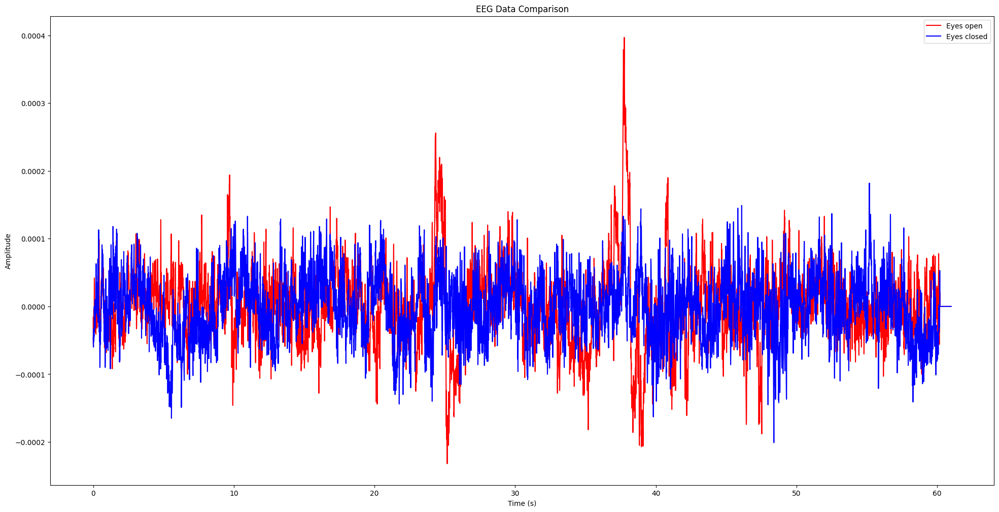

In [19]:
import matplotlib.pyplot as plt

# Load raw data from the .edf files
raw_1 = raw[0]
raw_2 = raw[1]

# Get the data and time vector from the raw objects
data_1, times_1 = raw_1[:, :]
data_2, times_2 = raw_2[:, :]

# Plot the data
plt.figure(figsize=(24, 12))

# Plot data from the first file
plt.plot(times_1, data_1[0, :], color='red', label='Eyes open')

# Plot data from the second file
plt.plot(times_2, data_2[0, :], color='blue', label='Eyes closed')

# Set labels and title
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('EEG Data Comparison')
plt.legend()

# Show plot
plt.show()


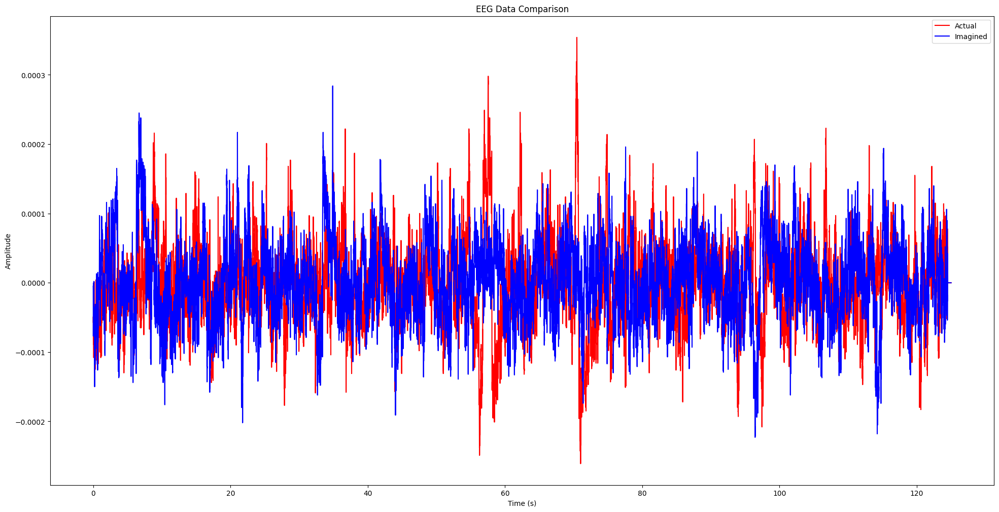

In [20]:
import matplotlib.pyplot as plt

# Load raw data from the .edf files
raw_1 = raw[2]
raw_2 = raw[3]

# Get the data and time vector from the raw objects
data_1, times_1 = raw_1[:, :]
data_2, times_2 = raw_2[:, :]

# Plot the data
plt.figure(figsize=(24, 12))

# Plot data from the first file
plt.plot(times_1, data_1[0, :], color='red', label='Actual')

# Plot data from the second file
plt.plot(times_2, data_2[0, :], color='blue', label='Imagined')

# Set labels and title
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('EEG Data Comparison')
plt.legend()

# Show plot
plt.show()


Effective window size : 12.800 (s)


c:\Users\HP\.conda\envs\ml_env\Lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


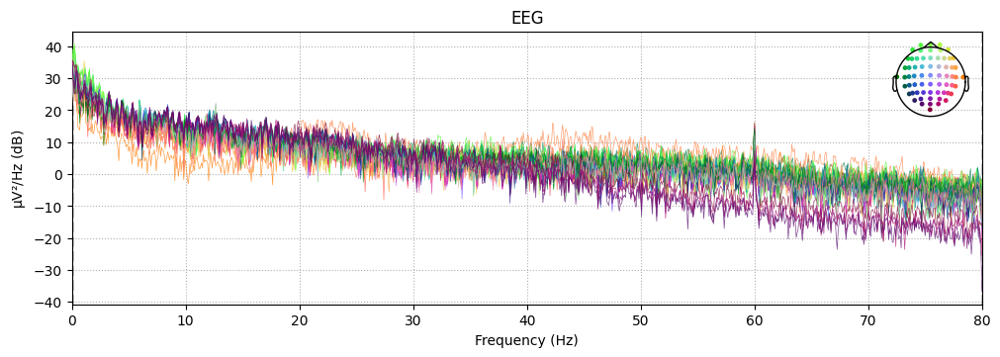

In [21]:
# eyes open plot for psd
raw[0].compute_psd().plot() 
plt.show()

Effective window size : 12.800 (s)


c:\Users\HP\.conda\envs\ml_env\Lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


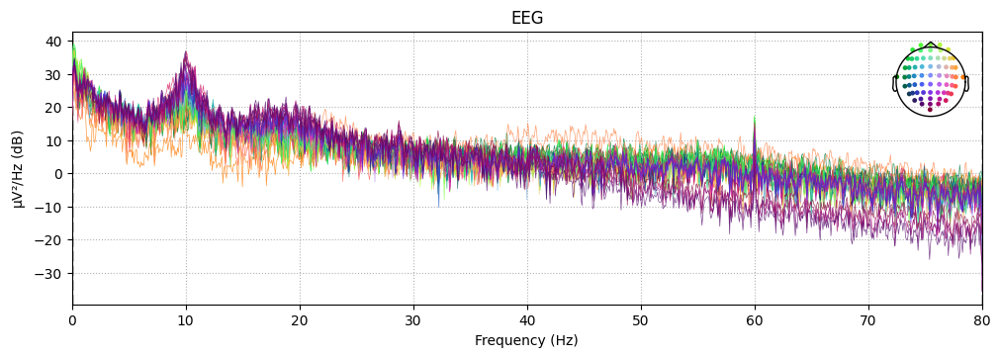

In [22]:
# eyes closed plot for psd
raw[1].compute_psd().plot()
plt.show()

Filtering a subset of channels. The highpass and lowpass values in the measurement info will not be updated.
Filtering raw data in 1 contiguous segment
Setting up low-pass filter at 79 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal lowpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Upper passband edge: 79.00 Hz
- Upper transition bandwidth: 1.00 Hz (-6 dB cutoff frequency: 79.50 Hz)
- Filter length: 529 samples (3.306 s)

Effective window size : 12.800 (s)


c:\Users\HP\.conda\envs\ml_env\Lib\site-packages\mne\viz\utils.py:165: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  (fig or plt).show(**kwargs)


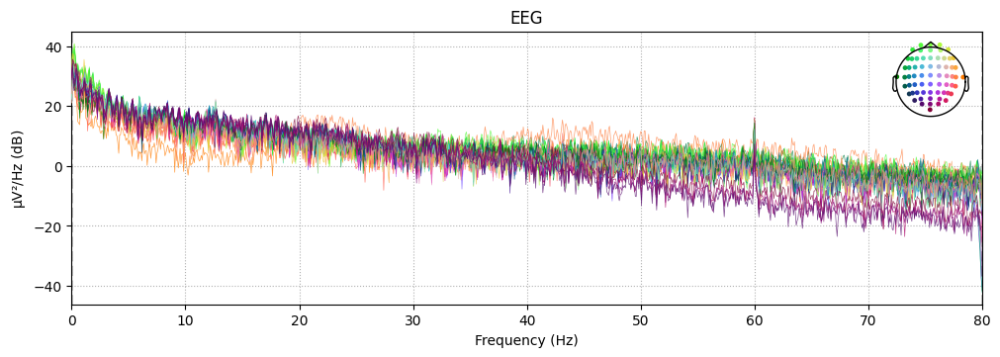

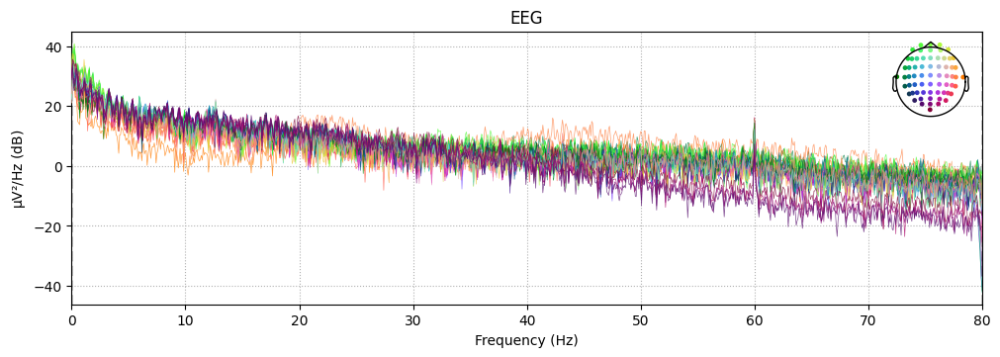

In [23]:
filteres_fist=raw[0].filter(l_freq=0,h_freq=79,picks=['FC5','P3'])
filteres_fist.compute_psd().plot()